# 1. Introduction

Final project, AI-based recommendation system for digital assets

#2. Import libraries

In [ ]:
# import packages

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import os
import glob
from pathlib import Path
import statistics
from sklearn import metrics
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import regularizers
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from keras import layers
from keras.utils.vis_utils import plot_model
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten, Input, Conv2D, MaxPooling2D, GlobalAveragePooling2D, LSTM
from PIL import Image
import pickle
import warnings
import requests
from datetime import datetime, timedelta
warnings.filterwarnings('ignore')

#3. Data loading

In [ ]:
# import dataset from Kaggle to Colab

!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle

!mkdir ./kaggle
!mv ./kaggle.json ./kaggle

!chmod 600 ~/.kaggle/kaggle.json

!kaggle datasets download -d kaushiksuresh147/metaverse-cryptos-historical-data

!mkdir ./data

if os.path.exists('data/Metaverse coins/') == False :
  !unzip -d ./data ./metaverse-cryptos-historical-data.zip 

cp: cannot stat 'kaggle.json': No such file or directory
mkdir: cannot create directory ‘./kaggle’: File exists
mv: cannot stat './kaggle.json': No such file or directory
metaverse-cryptos-historical-data.zip: Skipping, found more recently modified local copy (use --force to force download)
mkdir: cannot create directory ‘./data’: File exists


In [ ]:
# get token names

file_list = sorted(os.listdir('./data/Metaverse coins/'))

token_names = []

for i in range(len(file_list)):
  token_names.append(file_list[i].partition('.csv')[0])

token_names.remove('Battle Inu')
token_names.remove('Metaverse coins')
token_names.remove('Lelouch Lamperouge')

In [ ]:
# create dataframe

df = {}
for i in token_names:
  df[i] = pd.read_csv("./data/Metaverse coins/" + i + ".csv", index_col="Date", parse_dates=["Date"])
  df[i].drop(['Currency'], axis=1)

# 4. EDA

In [ ]:
# filter coins

filtered_names = []

for i in token_names:
  if len(df[i]) >= 365 * 3:
    filtered_names.append(i)

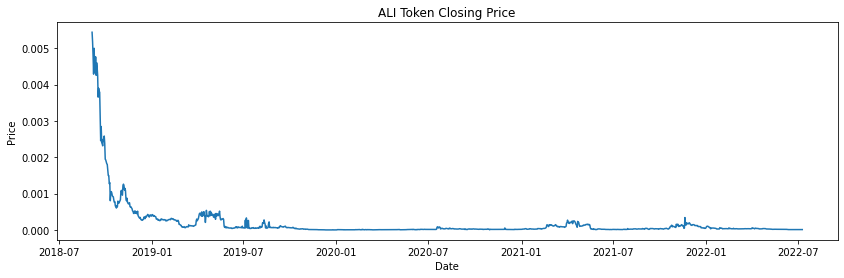

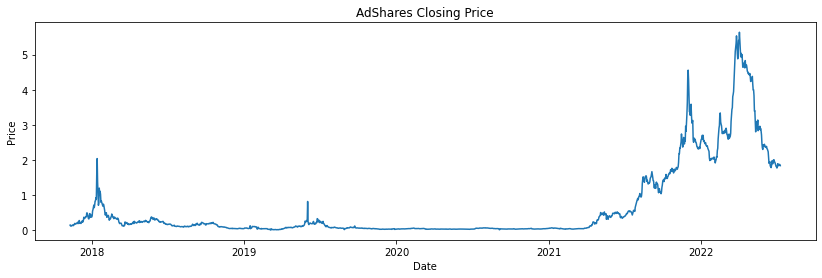

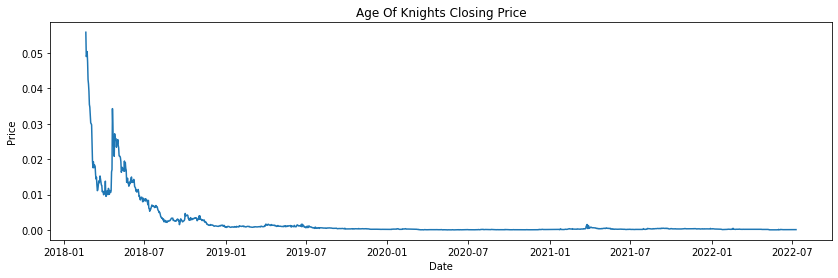

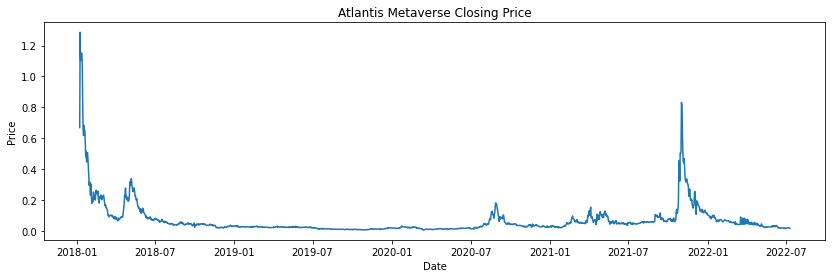

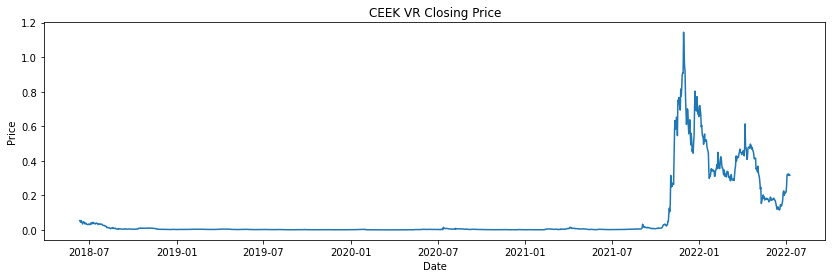

...

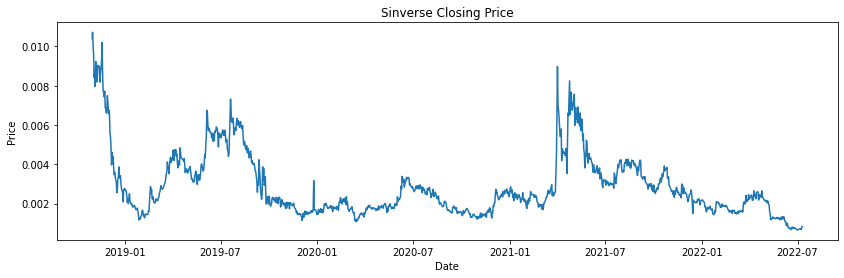

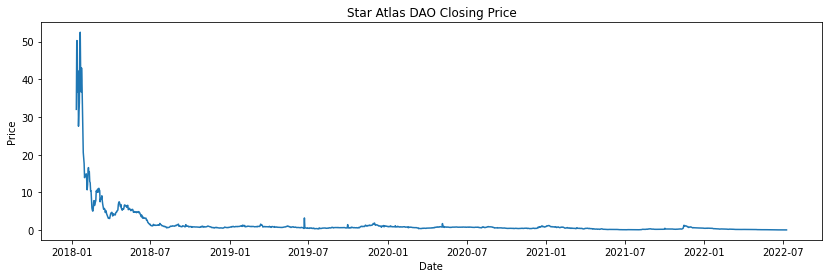

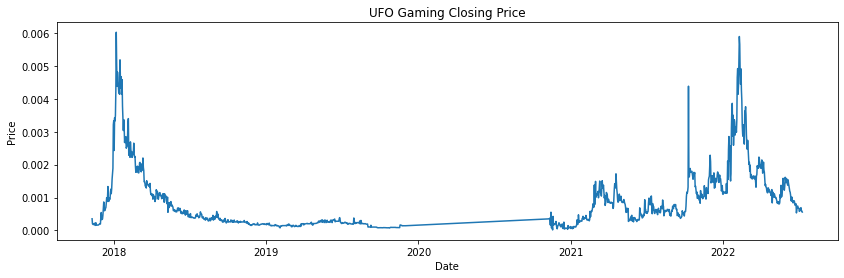

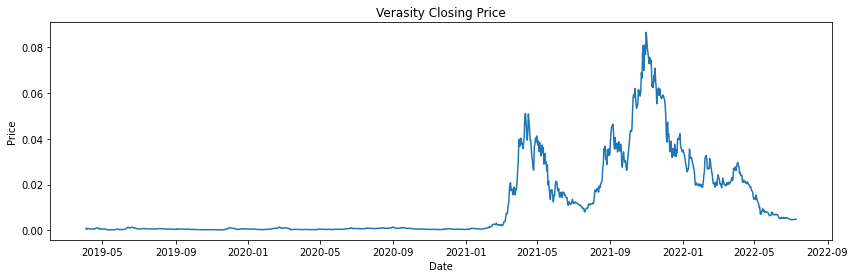

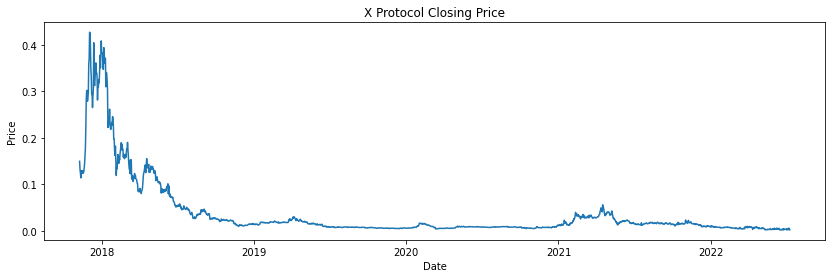

In [ ]:
# visualize data

for i in filtered_names:
#for i in token_names:
  plt.figure(figsize=(14,4))
  plt.plot(df[i]['Close'])
  plt.ylabel("Price")
  plt.xlabel("Date")
  plt.title(i + " Closing Price")

#5. Data preprocessing

In [ ]:
# calculate standard deviation

std = []

for i in filtered_names:
#for i in token_names:
  std.append(statistics.stdev(df[i]['Close']))

In [ ]:
# group tokens based on risk

risk_type = {}
risk_type['low'] = []
risk_type['medium'] = []
risk_type['high'] = []

group_range = max(std) - min(std)
group = group_range/3

for i, j in enumerate(filtered_names):
#for i, j in enumerate(token_names):
  if std[i] >= min(std) and std[i] < min(std) + group:
    risk_type['low'].append(j)
  elif std[i] >= min(std) + group and std[i] < 2 * group:
    risk_type['medium'].append(j)
  else:
    risk_type['high'].append(j)

In [ ]:
# filter out the last 100 days

#for i in filtered_names:
#  df[i] = df[i][:-100]

In [ ]:
# calculate growth

growths = []

for i in filtered_names:
#for i in token_names:
  growth = (df[i]['Close'].iloc[-1] - df[i]['Close'].iloc[0])/df[i]['Close'].iloc[0]
  growths.append(growth)

In [ ]:
# split train and test data

df_new = {}
for i in filtered_names:
#for i in token_names:
  df_new[i] = {}
  training_size = int(len(df[i])*0.65)
  test_size = len(df[i]) - training_size
  df_new[i]["Train"] = df[i][0:training_size] 
  df_new[i]["Test"] = df[i][training_size:len(df[i])]

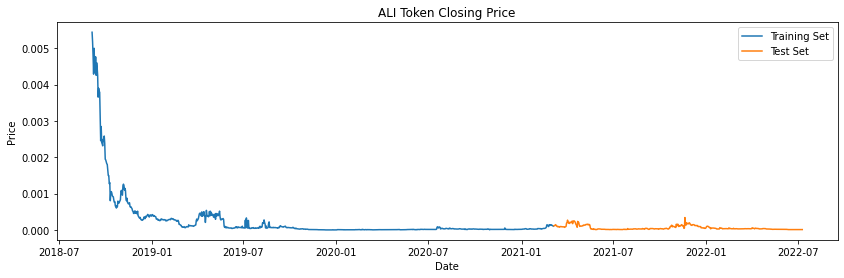

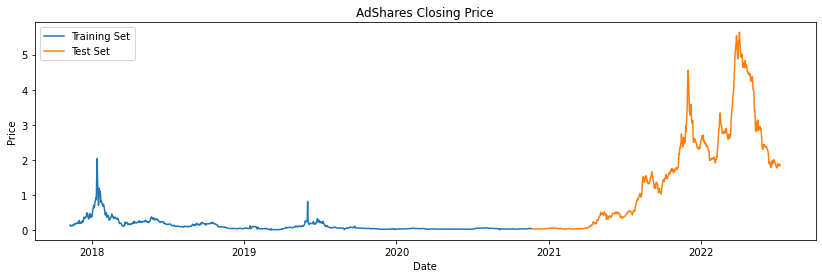

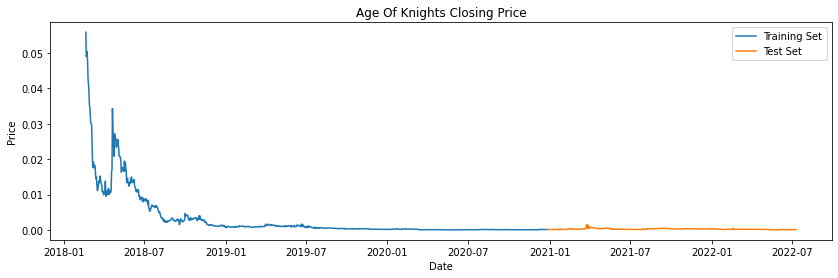

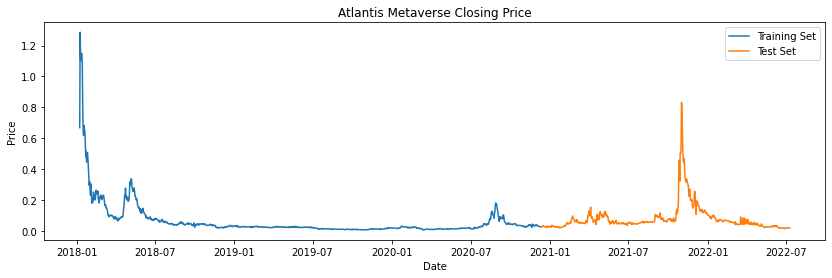

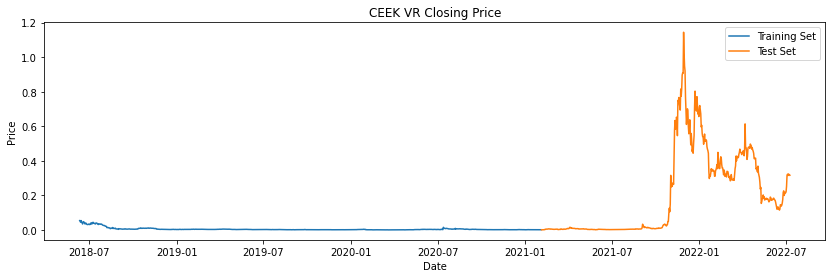

...

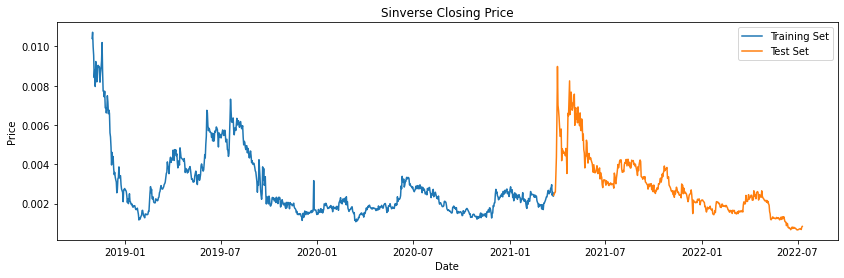

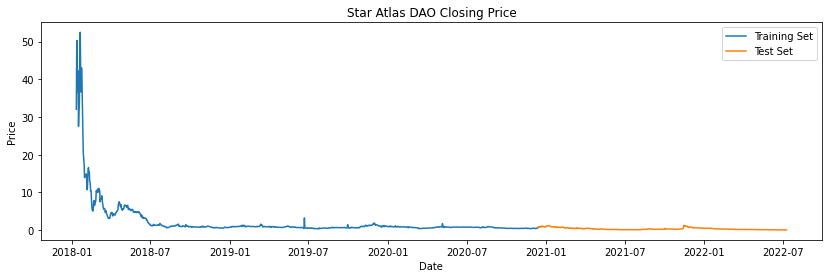

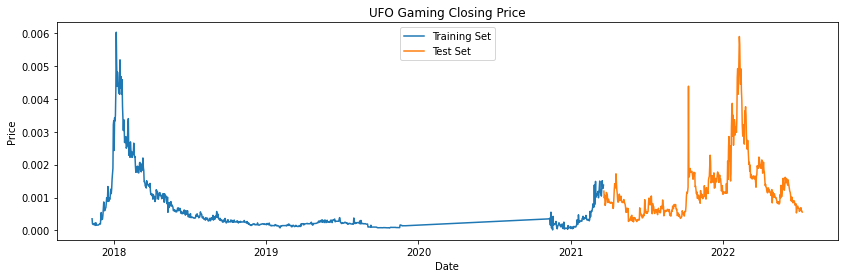

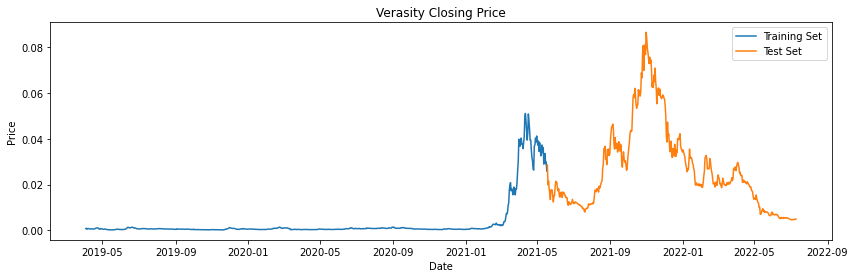

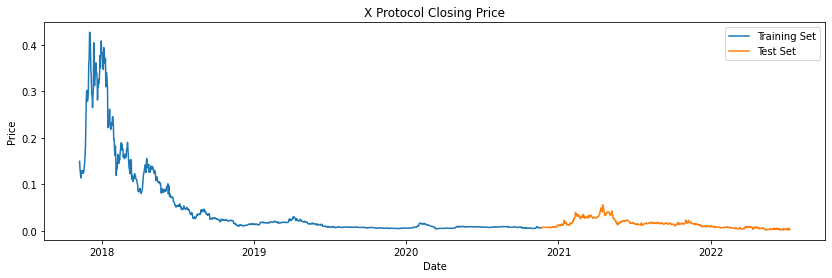

In [ ]:
# visualize train and test data

for i in filtered_names:
#for i in token_names:
  plt.figure(figsize=(14,4))
  plt.plot(df_new[i]["Train"]['Close'])
  plt.plot(df_new[i]["Test"]['Close'])
  plt.ylabel("Price")
  plt.xlabel("Date")
  plt.legend(["Training Set", "Test Set"])
  plt.title(i + " Closing Price")

In [ ]:
# scale data

transform_train = {}
transform_test = {}
scaler = {}

for num, i in enumerate(filtered_names):
#for num, i in enumerate(token_names):
  sc = MinMaxScaler(feature_range=(0,1))
  a0 = np.array(df_new[i]["Train"]['Close'])
  a1 = np.array(df_new[i]["Test"]['Close'])
  a0 = a0.reshape(a0.shape[0],1)
  a1 = a1.reshape(a1.shape[0],1)
  transform_train[i] = sc.fit_transform(a0)
  transform_test[i] = sc.fit_transform(a1)
  scaler[i] = sc

In [ ]:
# split X and y

trainset = {}
testset = {}
for j in filtered_names:
#for j in token_names:
  time_step = len(transform_train[j])//2
  #time_step = 7
  trainset[j] = {}
  X_train = []
  y_train = []
  for i in range(len(transform_train[j]) - time_step - 1):
    X_train.append(transform_train[j][i:(i + time_step), 0])
    y_train.append(transform_train[j][i + time_step, 0])
    X_train
  X_train, y_train = np.array(X_train), np.array(y_train)
  trainset[j]["X"] = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
  trainset[j]["y"] = y_train
    
  time_step = len(transform_test[j])//2
  testset[j] = {}
  X_test = []
  y_test = []    
  for i in range(len(transform_test[j]) - time_step -  1):
    X_test.append(transform_test[j][i:(i + time_step), 0])
    y_test.append(transform_test[j][i + time_step, 0])
  X_test, y_test = np.array(X_test), np.array(y_test)
  testset[j]["X"] = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))
  testset[j]["y"] = y_test

In [ ]:
# summarize shapes

arr_buff = []

for i in filtered_names:
#for i in token_names:
  buff = {}
  buff["X_train"] = trainset[i]["X"].shape
  buff["y_train"] = trainset[i]["y"].shape
  buff["X_test"] = testset[i]["X"].shape
  buff["y_test"] = testset[i]["y"].shape
  arr_buff.append(buff)

pd.DataFrame(arr_buff, index=filtered_names)
#pd.DataFrame(arr_buff, index=token_names)

,X_train,y_train,X_test,y_test
ALI Token,"(456, 456, 1)","(456,)","(245, 246, 1)","(245,)"
AdShares,"(553, 554, 1)","(553,)","(298, 298, 1)","(298,)"
Age Of Knights,"(520, 520, 1)","(520,)","(280, 280, 1)","(280,)"
Atlantis Metaverse,"(534, 534, 1)","(534,)","(287, 288, 1)","(287,)"
CEEK VR,"(484, 484, 1)","(484,)","(260, 261, 1)","(260,)"
Decentraland,"(553, 554, 1)","(553,)","(298, 298, 1)","(298,)"
Drive 2,"(522, 522, 1)","(522,)","(281, 282, 1)","(281,)"
Enjin Coin,"(553, 554, 1)","(553,)","(298, 298, 1)","(298,)"
Fistiana,"(553, 554, 1)","(553,)","(298, 298, 1)","(298,)"
GameCredits,"(553, 554, 1)","(553,)","(298, 298, 1)","(298,)"


#6. Model definition

In [ ]:
# define architecture

regressor = Sequential()
regressor.add(LSTM(units=50, return_sequences=True, input_shape=(None,1)))
regressor.add(Dropout(0.2))
regressor.add(LSTM(units=50, return_sequences=True))
regressor.add(Dropout(0.2))
regressor.add(LSTM(units=50, return_sequences=True))
regressor.add(Dropout(0.5))
regressor.add(LSTM(units=50))
regressor.add(Dropout(0.5))
regressor.add(Dense(units=1))

In [ ]:
# compile model

regressor.compile(optimizer='rmsprop', loss='mean_squared_error')

#7. Model training

In [ ]:
# train model

for i in filtered_names:
#for i in token_names:
  print("Fitting to", i)
  regressor.fit(trainset[i]["X"], trainset[i]["y"], epochs=10, batch_size=32)

Fitting to ALI Token
Epoch 1/10
15/15 [==============================] - 7s 74ms/step - loss: 4.2731e-04
Epoch 2/10
15/15 [==============================] - 1s 70ms/step - loss: 4.2942e-05
Epoch 3/10
15/15 [==============================] - 1s 70ms/step - loss: 6.2740e-05
Epoch 4/10
15/15 [==============================] - 1s 70ms/step - loss: 4.6769e-05
Epoch 5/10
15/15 [==============================] - 1s 70ms/step - loss: 4.4253e-05
Epoch 6/10
15/15 [==============================] - 1s 70ms/step - loss: 3.9522e-05
Epoch 7/10
15/15 [==============================] - 1s 70ms/step - loss: 3.7894e-05
Epoch 8/10
15/15 [==============================] - 1s 70ms/step - loss: 3.9771e-05
Epoch 9/10
15/15 [==============================] - 1s 70ms/step - loss: 4.3645e-05
Epoch 10/10
15/15 [==============================] - 1s 70ms/step - loss: 3.2763e-05
Fitting to AdShares
Epoch 1/10
18/18 [==============================] - 5s 85ms/step - loss: 9.2897e-04
Epoch 2/10
18/18 [================

#8. Model evaluation

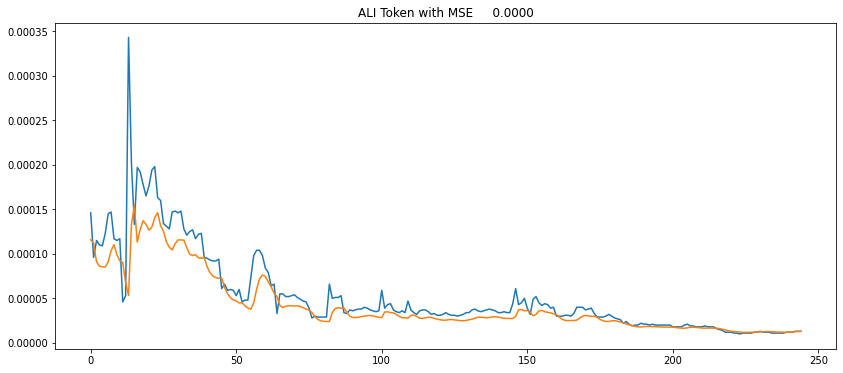

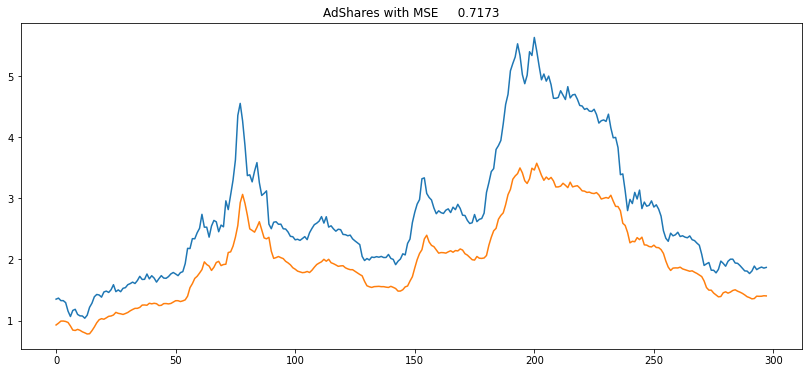

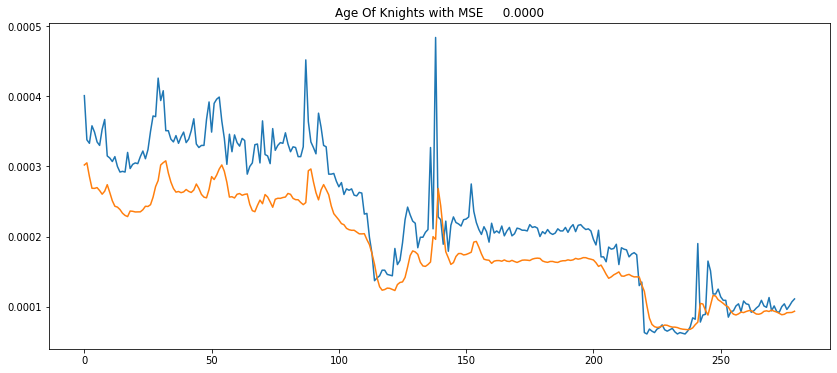

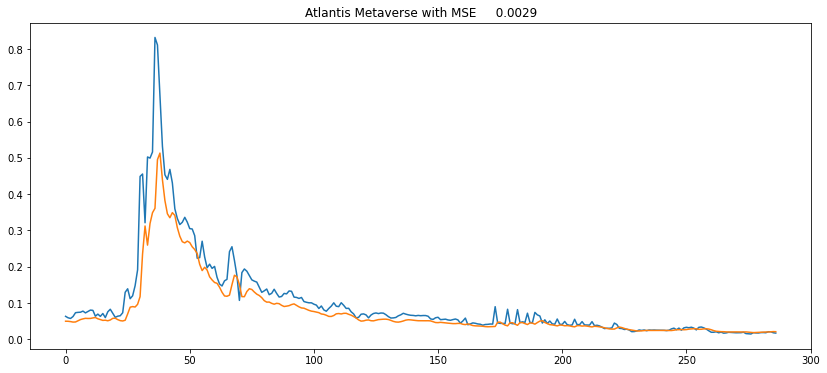

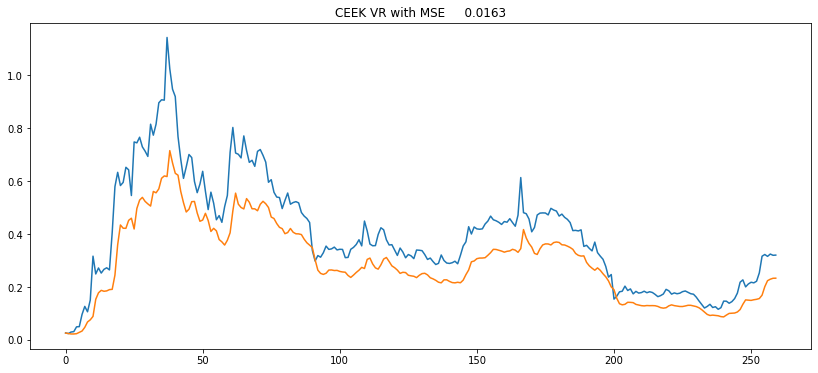

...

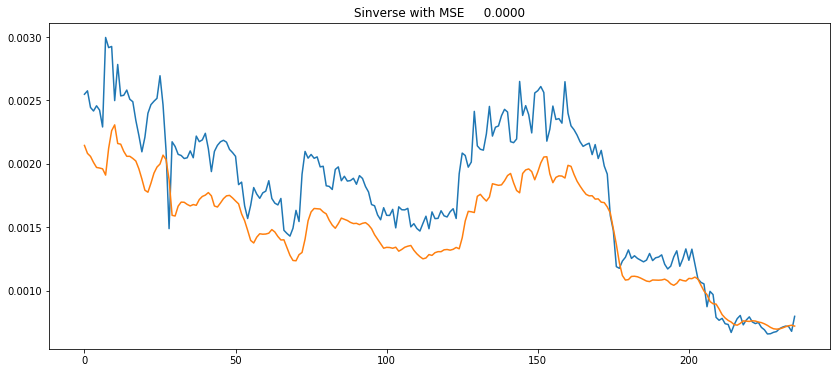

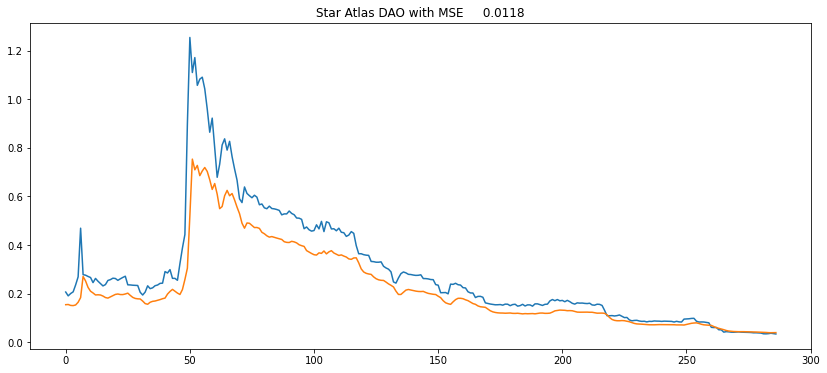

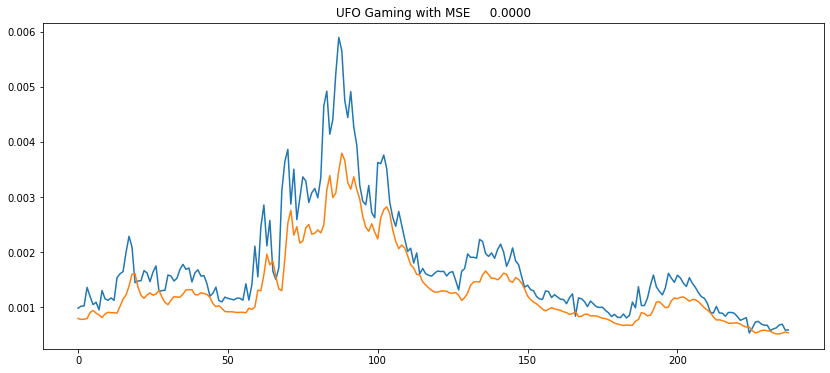

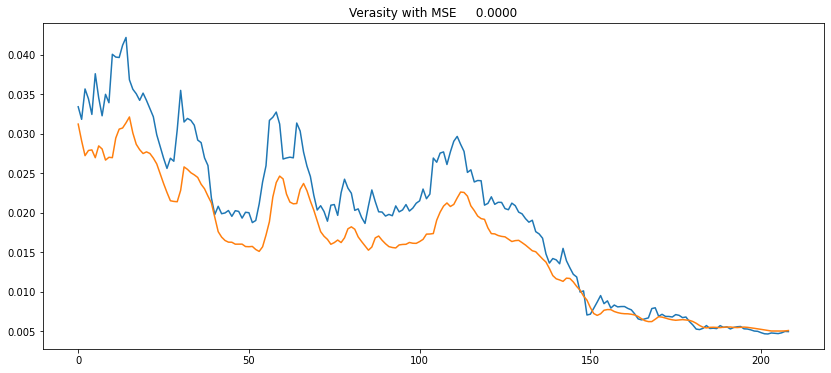

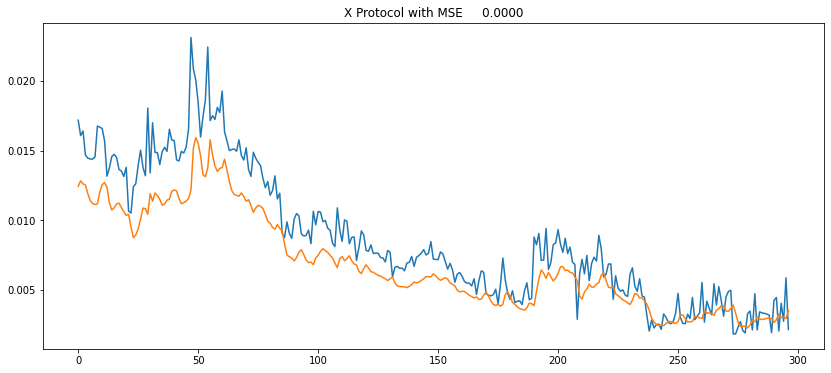

In [ ]:
# make predictions

for i in filtered_names:
#for i in token_names:
  y_true = scaler[i].inverse_transform(testset[i]["y"].reshape(-1,1))
  y_pred = scaler[i].inverse_transform(regressor.predict(testset[i]["X"]))
  MSE = mean_squared_error(y_true, y_pred)
  
  plt.figure(figsize=(14,6))
  plt.title("{} with MSE {:10.4f}".format(i,MSE))
  plt.plot(y_true)
  plt.plot(y_pred)

#9. Model saving

In [ ]:
with open("regressor_model.pkl", "wb") as model_file:
  pickle.dump(regressor, model_file)

#10. Model inference

In [ ]:
# define function for multi-step prediction

original_prices = []
future_prices = []
container = []

def long_predict(name, days):
  y_future = []

  original_prices.append(testset[name]["y"][-1])
  x_pred = testset[name]['X'][-1:, :, :]
  y_pred = testset[name]["y"][-1]

  for i in range(days):
    x_pred = np.append(x_pred[:, 1:, :], y_pred.reshape(1, 1, 1), axis=1)
    y_pred = regressor.predict(x_pred)
    y_future.append(y_pred.flatten()[0])

  y_future = np.array(y_future).reshape(-1, 1)
  y_future = scaler[name].inverse_transform(y_future)
  future_prices.append(y_future[0][-1])

  df_past = df[name][['Close']].reset_index()
  df_past.rename(columns={'index': 'Date'}, inplace=True)
  df_past['Date'] = pd.to_datetime(df_past['Date'])
  df_past['Forecast'] = np.nan

  df_future = pd.DataFrame(columns=['Date', 'Close', 'Forecast'])
  df_future['Date'] = pd.date_range(start=df_past['Date'].iloc[-1] + pd.Timedelta(days=1), periods=days)
  df_future['Forecast'] = y_future.flatten()
  df_future['Close'] = np.nan

  results = df_past.append(df_future).set_index('Date')

  plt.figure(figsize=(14,6))
  plt.title(name)
  plt.plot(results)

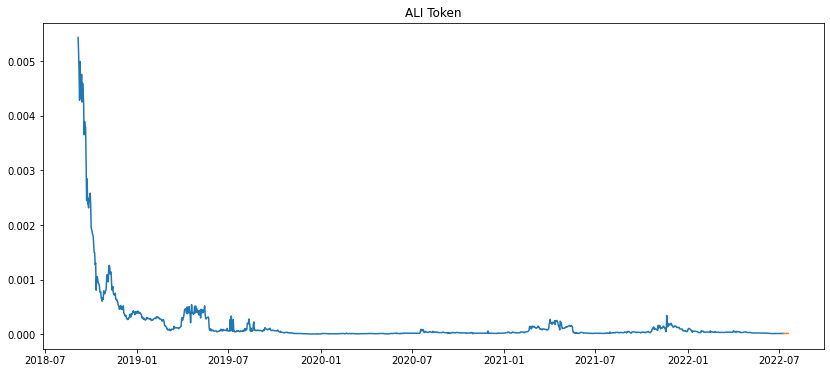

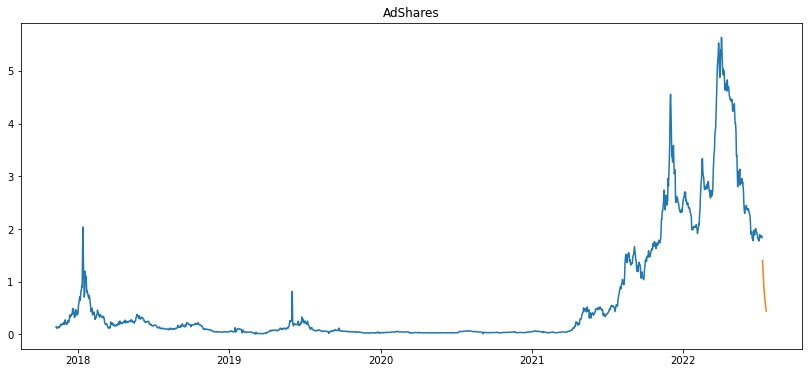

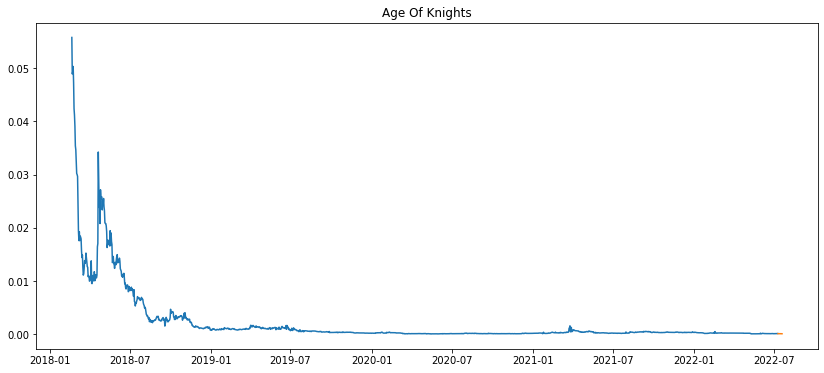

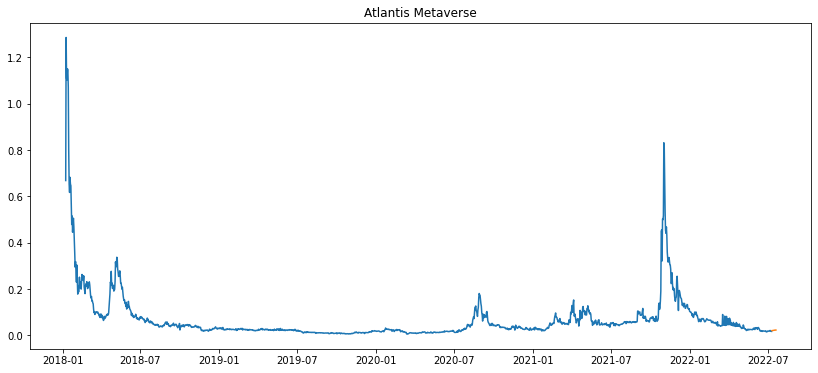

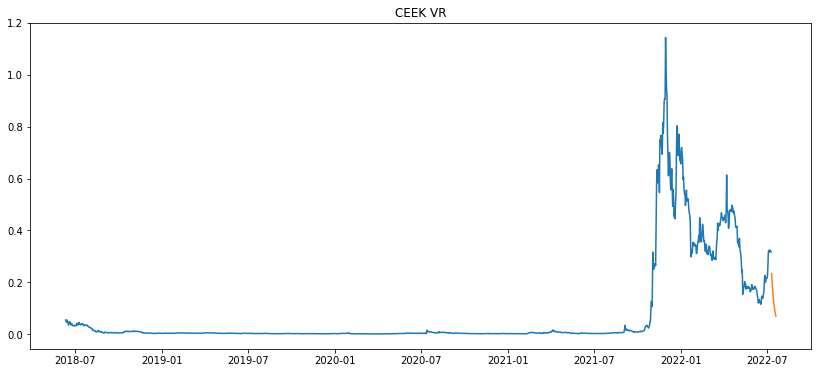

...

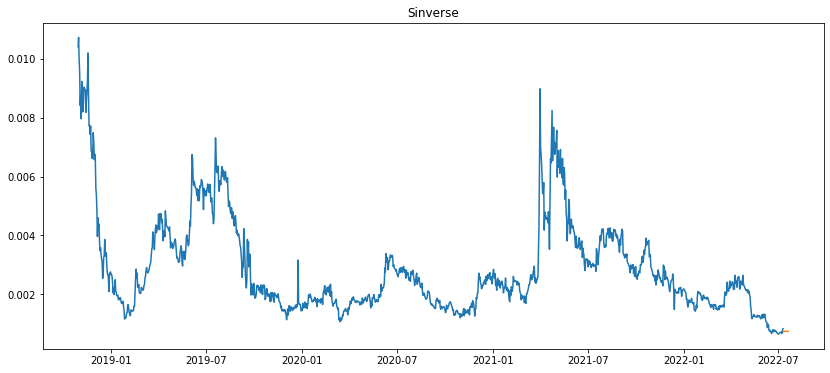

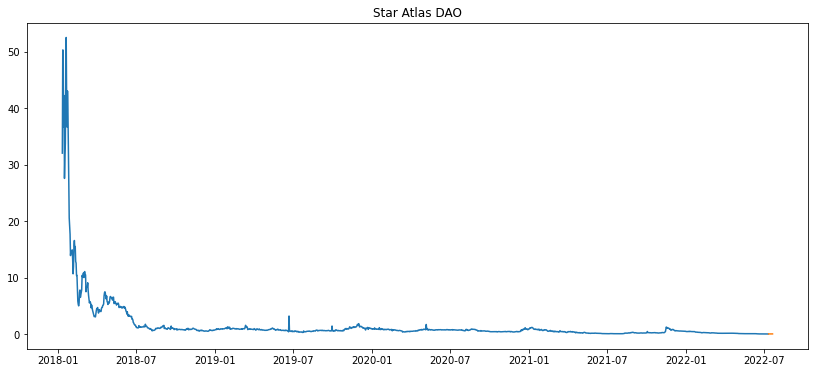

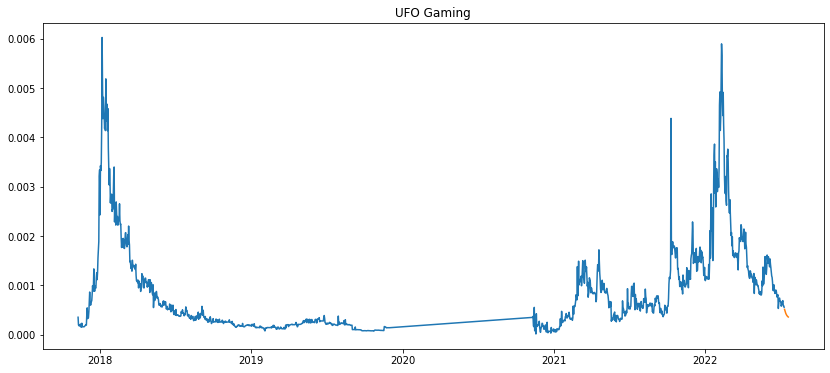

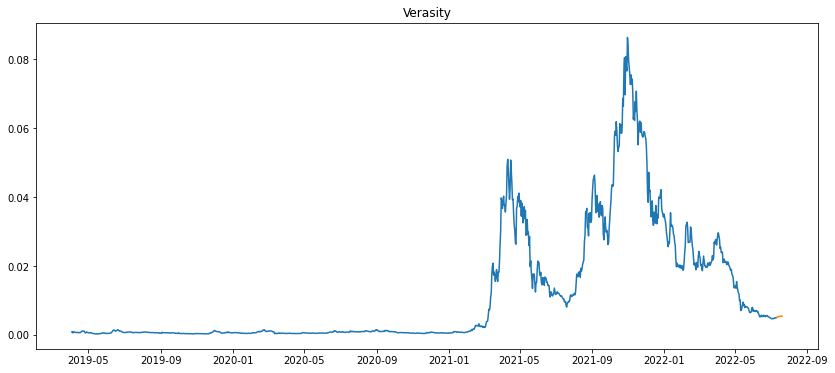

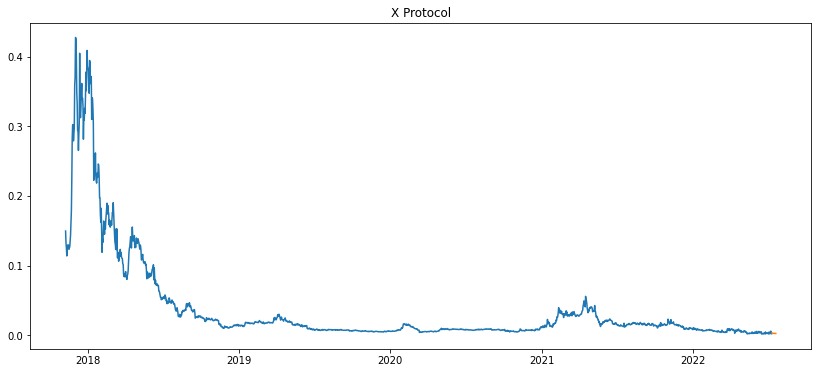

In [ ]:
# make multi-step predictions

for i in filtered_names:
#for i in token_names:
  long_predict(i, 10)

In [94]:
# store results

result = pd.DataFrame()
result['token'] = filtered_names
result['original_prices'] = original_prices
result['future_prices'] = future_prices
result['growth'] = result['future_prices']/result['original_prices'] - 1
result['risk'] = np.nan
result['recommendation'] = np.nan
result['symbols'] = ['ALI', 'ADS', 'GEM', 'TAU', 'CEEK', 'MANA', 'DMT', 'ENJ', 'FCT', 'GAME', 'KT', 'ORB', 'MST', 'MAC', 'MAN', 'MDT', 'MTC', 'META', 'MONA', 'AAA', 'PLA', 'SIN', 'POLIS', 'UFO', 'VRA', 'POT']

for i, value in enumerate(filtered_names):
  if value in risk_type['low']:
    result['risk'].iloc[i] = 'low'
  elif value in risk_type['medium']:
    result['risk'].iloc[i] = 'medium'
  else:
    result['risk'].iloc[i] = 'high'

for i, value in enumerate(filtered_names):
  if result['growth'].iloc[i] > 0:
    result['recommendation'].iloc[i] = 'buy'
  else:
    result['recommendation'].iloc[i] = 'sell'

result

,token,original_prices,future_prices,growth,risk,recommendation,symbols
0,ALI Token,0.009009,0.000013,-0.998542,low,sell,ALI
1,AdShares,0.328611,1.405632,3.277497,low,buy,ADS
2,Age Of Knights,0.033201,0.000096,-0.997110,low,sell,GEM
3,Atlantis Metaverse,0.002994,0.020583,5.875069,low,buy,TAU
4,CEEK VR,0.279196,0.233631,-0.163203,low,sell,CEEK
5,Decentraland,0.153998,0.672040,3.363963,low,buy,MANA
6,Drive 2,0.001804,0.012508,5.933554,low,buy,DMT
7,Enjin Coin,0.095261,0.424128,3.452296,low,buy,ENJ
8,Fistiana,0.001111,0.252074,225.935985,high,buy,FCT
9,GameCredits,0.019210,0.016123,-0.160678,low,sell,GAME


In [95]:
# deconstruct to be built on the backend

print(f"token = {result['token'].tolist()}")
print(f"original_prices = {result['original_prices'].tolist()}")
print(f"future_prices = {result['future_prices'].tolist()}")
print(f"growth = {result['growth'].tolist()}")
print(f"risk = {result['risk'].tolist()}")
print(f"recommendation = {result['recommendation'].tolist()}")
print(f"symbols = {result['symbols'].tolist()}")

token = ['ALI Token', 'AdShares', 'Age Of Knights', 'Atlantis Metaverse', 'CEEK VR', 'Decentraland', 'Drive 2', 'Enjin Coin', 'Fistiana', 'GameCredits', 'KingdomX', 'KlayCity', 'MStation', 'Magic Metaverse', 'MangaMon', 'Meta Dance Token', 'MetaCars', 'Metaverse Miner', 'Monavale', 'Moon Rabbit', 'PlayDapp', 'Sinverse', 'Star Atlas DAO', 'UFO Gaming', 'Verasity', 'X Protocol']
original_prices = [0.009009009525727724, 0.32861077253194404, 0.03320053149075533, 0.0029938289524685385, 0.279196300157807, 0.153997532226834, 0.0018040174615156427, 0.09526050235854708, 0.0011107735084844583, 0.019209789881132835, 0.6161988571754959, 0.06174926444372217, 0.003030115798964131, 0.16621370596038176, 0.011224015220876672, 0.07299748470105882, 0.04844021552926039, 0.016174810321490388, 0.010843669410543239, 0.017684890896706953, 0.015267177506943359, 0.0167087409858082, 0.0008265611199306522, 0.05804046686719992, 0.0036570863977862383, 0.005999331789919661]
future_prices = [1.3134313121554442e-05, 1

In [ ]:
prices = []
def get_data(symbol):
  for i in range(13, 1, -1):
    url = f'https://rest.coinapi.io/v1/quotes/current'
    headers={"X-CoinAPI-Key": "004D4DE3-D4F9-4C91-8535-BB9552467393"}
    response = requests.get(url, headers=headers)
    prices.append(response.json()[0]['ask_price'])
  return prices

sc = MinMaxScaler(feature_range=(0,1))
def predict_future(symbol):
  a0 = np.array(get_data(symbol))
  a0 = a0.reshape(a0.shape[0],1)
  transform_inf = sc.fit_transform(a0)
  scaler_inf = {}
  scaler_inf = sc

  time_step = 7
  testset_inf = pd.DataFrame()
  X_test = []
  y_test = []
  testset_inf = {}

  for i in range(len(transform_inf) - time_step -  1):
    X_test.append(transform_inf[i:(i + time_step), 0])
    y_test.append(transform_inf[i + time_step, 0])
  
  X_test, y_test = np.array(X_test), np.array(y_test)
  testset_inf["X"] = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))
  testset_inf["y"] = y_test
  y_future = []

  x_pred = testset_inf['X'][-1:, :, :]
  y_pred = testset_inf["y"][-1]

  for i in range(10):
    x_pred = np.append(x_pred[:, 1:, :], y_pred.reshape(1, 1, 1), axis=1)
    y_pred = regressor.predict(x_pred)
    y_future.append(y_pred.flatten()[0])

  y_future = np.array(y_future).reshape(-1, 1)
  y_future = scaler_inf.inverse_transform(y_future)
  return y_future[0][0]

In [ ]:
url = f'https://rest.coinapi.io/v1/quotes/current'
headers={"X-CoinAPI-Key": "004D4DE3-D4F9-4C91-8535-BB9552467393"}
response = requests.get(url, headers=headers)
response.text

'[\n  {\n    "symbol_id": "CASHIEREST_SPOT_RNX_USDT",\n    "time_exchange": "2022-09-01T12:48:12.9664786Z",\n    "time_coinapi": "2022-09-01T12:48:12.9664786Z",\n    "ask_price": 0.00001700,\n    "ask_size": 15932208.96190166,\n    "bid_price": 0.00001100,\n    "bid_size": 48435693.85284342,\n    "last_trade": {\n      "time_exchange": "2022-09-01T17:43:50.0000000Z",\n      "time_coinapi": "2022-09-01T08:49:05.3208032Z",\n      "uuid": "c482172a-d054-40ad-98d3-5b6ebe7493e7",\n      "price": 0.00001400,\n      "size": 17357867.53787822,\n      "taker_side": "SELL"\n    }\n  },\n  {\n    "symbol_id": "CASHIEREST_SPOT_MYCE_USDT",\n    "time_exchange": "2022-09-01T09:40:32.1066525Z",\n    "time_coinapi": "2022-09-01T09:40:32.1066525Z",\n    "ask_price": 0.00051200,\n    "ask_size": 7893.51953125,\n    "bid_price": 0.00047200,\n    "bid_size": 83510.08948241,\n    "last_trade": {\n      "time_exchange": "2022-09-01T22:16:40.0000000Z",\n      "time_coinapi": "2022-09-01T13:16:42.3683446Z",\n

In [92]:
response.json()

[{'symbol_id': 'CASHIEREST_SPOT_RNX_USDT',
  'time_exchange': '2022-09-01T12:48:12.9664786Z',
  'time_coinapi': '2022-09-01T12:48:12.9664786Z',
  'ask_price': 1.7e-05,
  'ask_size': 15932208.96190166,
  'bid_price': 1.1e-05,
  'bid_size': 48435693.85284342,
  'last_trade': {'time_exchange': '2022-09-01T17:43:50.0000000Z',
   'time_coinapi': '2022-09-01T08:49:05.3208032Z',
   'uuid': 'c482172a-d054-40ad-98d3-5b6ebe7493e7',
   'price': 1.4e-05,
   'size': 17357867.53787822,
   'taker_side': 'SELL'}},
 {'symbol_id': 'CASHIEREST_SPOT_MYCE_USDT',
  'time_exchange': '2022-09-01T09:40:32.1066525Z',
  'time_coinapi': '2022-09-01T09:40:32.1066525Z',
  'ask_price': 0.000512,
  'ask_size': 7893.51953125,
  'bid_price': 0.000472,
  'bid_size': 83510.08948241,
  'last_trade': {'time_exchange': '2022-09-01T22:16:40.0000000Z',
   'time_coinapi': '2022-09-01T13:16:42.3683446Z',
   'uuid': '35817a3d-7d4f-49c2-b05e-1bb8db3063a7',
   'price': 0.000502,
   'size': 52188.25099602,
   'taker_side': 'SELL'}}